In [1]:
import numpy as np, uproot as ur, awkward as ak, pandas as pd
import matplotlib.pyplot as plt
import os, sys
import pickle
import scipy.stats as st
from collections import defaultdict
from scipy.optimize import curve_fit
from matplotlib.colors import LogNorm
from matplotlib.patches import Rectangle
from scipy.stats import poisson, norm
from scipy.spatial import ConvexHull


import mplhep as hep
plt.figure()
hep.style.use("CMS")
plt.close()

def gaus(x, amp, mean, sigma):
    return amp * np.exp( -(x - mean)**2 / (2*sigma**2) ) 

def phi_reconstruct(x, y, z):
    return np.degrees(np.arctan2(y, x))
    
def theta_reconstruct(x, y, z):
    return np.degrees(np.arccos(abs(z)/np.sqrt(x**2+y**2+z**2)))

def phi_reconstruct(x, y, z):
    return np.degrees(np.arctan2(y, x))

def theta_x_y(x, y, z):
    data = np.concatenate((np.array(x)[:, np.newaxis], 
                           np.array(y)[:, np.newaxis], 
                           np.array(z)[:, np.newaxis]), 
                          axis=1)
    datamean = data.mean(axis=0)
    centered_data = data - datamean

    _, _, vv = np.linalg.svd(centered_data)
    direction_vector = vv[0]
    if direction_vector[2] > 0:
        direction_vector *= -1
        
    x_vec, y_vec, z_vec = direction_vector
    
    tanx = theta_x(x_vec, y_vec, z_vec)
    tany = theta_y(x_vec, y_vec, z_vec)
    
    return tanx, tany

def vector_angle_reconstruct(x, y, z):
    data = np.concatenate((np.array(x)[:, np.newaxis], 
                           np.array(y)[:, np.newaxis], 
                           np.array(z)[:, np.newaxis]), 
                          axis=1)
    datamean = data.mean(axis=0)
    centered_data = data - datamean

    _, _, vv = np.linalg.svd(centered_data)
    direction_vector = vv[0]
    if direction_vector[2] > 0:
        direction_vector *= -1
        
    x_vec, y_vec, z_vec = direction_vector
    
    theta = theta_reconstruct(x_vec, y_vec, z_vec)
    phi = phi_reconstruct(x_vec, y_vec, z_vec)
    
    return theta, phi


In [4]:
with open(f'../hepmc/100M_events.txt','r') as f:
    lines = f.read()

In [5]:
import re

In [6]:
pattern = r"x,y,zx,y,z=\s*([-+]?\d*\.\d+|\d+)\s+([-+]?\d*\.\d+|\d+)\s+([-+]?\d*\.\d+|\d+)"

coords = re.findall(pattern, lines)

# Convert strings to floats
coords = np.array([[float(x), float(y), float(z)] for x, y, z in coords[:100]])

In [7]:
plt.scatter(coords[:,0]*100,coords[:,1]*100)
plt.xlabel('X (cm)')
plt.ylabel('Y (cm)')

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [1]:
arrays={}
arrays['muon']=ur.open(f"~/muography/data/AI/test.root:events").arrays()

NameError: name 'ur' is not defined

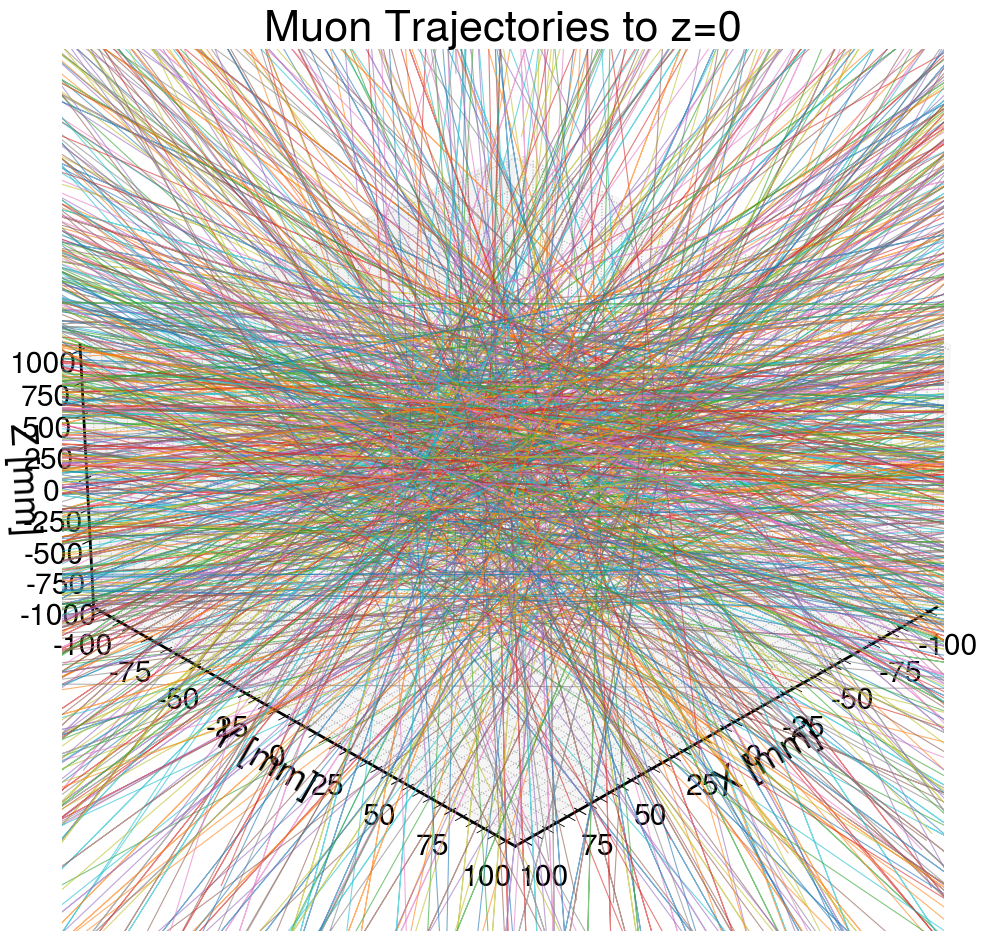

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
num = 1000
# Assuming you have these arrays:
x = arrays['muon']["MCParticles.vertex.x"][:num]  # in mm
y = arrays['muon']["MCParticles.vertex.y"][:num]  # in mm
z = arrays['muon']["MCParticles.vertex.z"][:num]  # in mm
px = arrays['muon']["MCParticles.momentum.x"][:num]  # in MeV/c
py = arrays['muon']["MCParticles.momentum.y"][:num]  # in MeV/c
pz = arrays['muon']["MCParticles.momentum.z"][:num]  # in MeV/c
status = arrays['muon']["MCParticles.generatorStatus"][:num]  # particle status codes

# Create figure
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Filter for final state particles (status=1)
mask = (status == 1)
x = x[mask]
y = y[mask]
z = z[mask]
px = px[mask]
py = py[mask]
pz = pz[mask]

# Calculate direction vectors (unit vectors)
p_mag = np.sqrt(px**2 + py**2 + pz**2)
ux = px / p_mag
uy = py / p_mag
uz = pz / p_mag

# Plot each particle trajectory
for i in range(len(x)):
    # Starting point
    x0, y0, z0 = x[i], y[i], z[i]
    
    # Calculate intersection with z=0 plane
    t = -z0 / uz[i]  # parametric distance to z=0
    x_end = x0 + ux[i] * t
    y_end = y0 + uy[i] * t
    
    # Create points along the trajectory
    z_points = np.linspace(z0, 0, 50)
    x_points = x0 + ux[i] * (z_points - z0)/uz[i]
    y_points = y0 + uy[i] * (z_points - z0)/uz[i]
    
    # Plot the trajectory
    ax.plot(np.array(ak.flatten(x_points)), np.array(ak.flatten(y_points)), np.array(ak.flatten(z_points)), 
            alpha=0.6, linewidth=0.8)


# Formatting
ax.set_xlabel('X [mm]')
ax.set_ylabel('Y [mm]')
ax.set_zlabel('Z [mm]')
ax.set_title('Muon Trajectories to z=0')
#ax.view_init(elev=30, azim=45)

ax.set_zlim(-1,1000)
#ax.set_ylim(-300,300)
#ax.set_xlim(-300,300)


# Add colorbar for momentum magnitude
plt.tight_layout()
#plt.show()

# Set axis limits
#max_dim = max(ZDC_width, ZDC_height, ZDC_length, radius*2)
ax.set_xlim(-100, 100)
ax.set_ylim(-100, 100)
ax.set_zlim(-1000, 1000)
#ax.set_xlim(-100,100)
#ax.set_ylim(-100,100)

ax.view_init(elev=30., azim=45)
# Equal aspect ratio
ax.set_box_aspect([1, 1, 0.5])  # Z dimension is smaller

plt.show()

In [5]:
energy = arrays['muon'][f'MuographyHits.energy']*1000

y,x=np.histogram(ak.flatten(energy) ,bins=100, range=(0, 4))
bc=(x[1:]+x[:-1])/2
MIP=list(bc[y==max(y)])[0] 
MIP_cut = energy > 0.2*MIP/1000

In [6]:
cell_cut = ak.num(arrays['muon'][f'MuographyHits.energy'][MIP_cut], axis=1) >= 2
pos_x = arrays['muon']["MuographyHits.position.x"][MIP_cut][cell_cut]
pos_y = arrays['muon']["MuographyHits.position.y"][MIP_cut][cell_cut]
pos_z = arrays['muon']["MuographyHits.position.z"][MIP_cut][cell_cut]
avg_x = ak.mean(pos_x, axis=1)
avg_y = ak.mean(pos_y, axis=1)
avg_z = ak.mean(pos_z, axis=1)

Text(0.5, 0, 'Z [mm]')

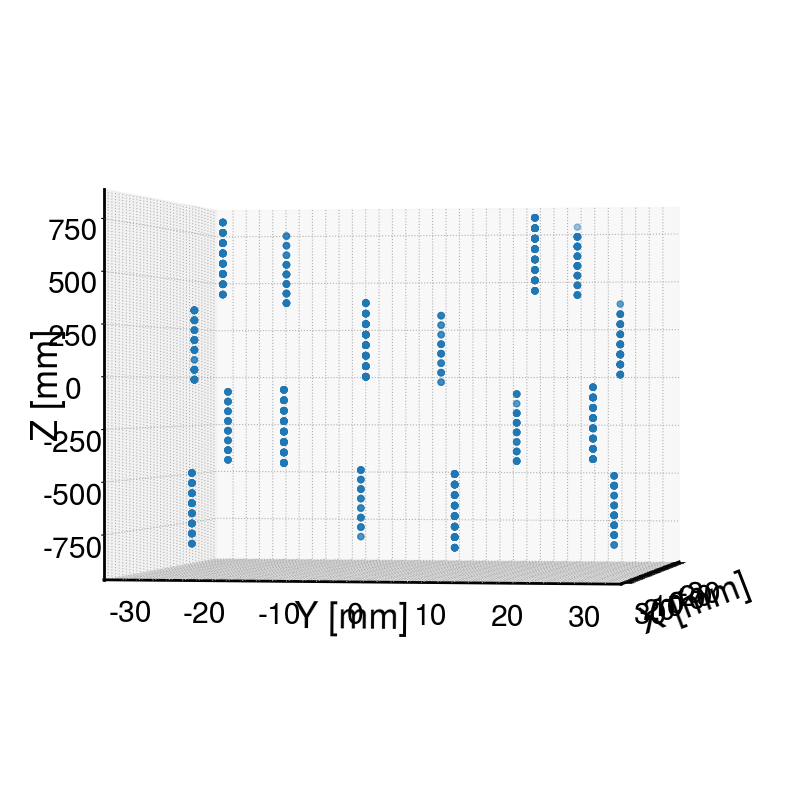

In [7]:
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')
plt.sca(ax)
ax.scatter(ak.flatten(pos_x)[:1000],ak.flatten(pos_y)[:1000],ak.flatten(pos_z)[:1000])
ax.view_init(elev=0, azim=10)
ax.set_xlabel('X [mm]')
ax.set_ylabel('Y [mm]')
ax.set_zlabel('Z [mm]')

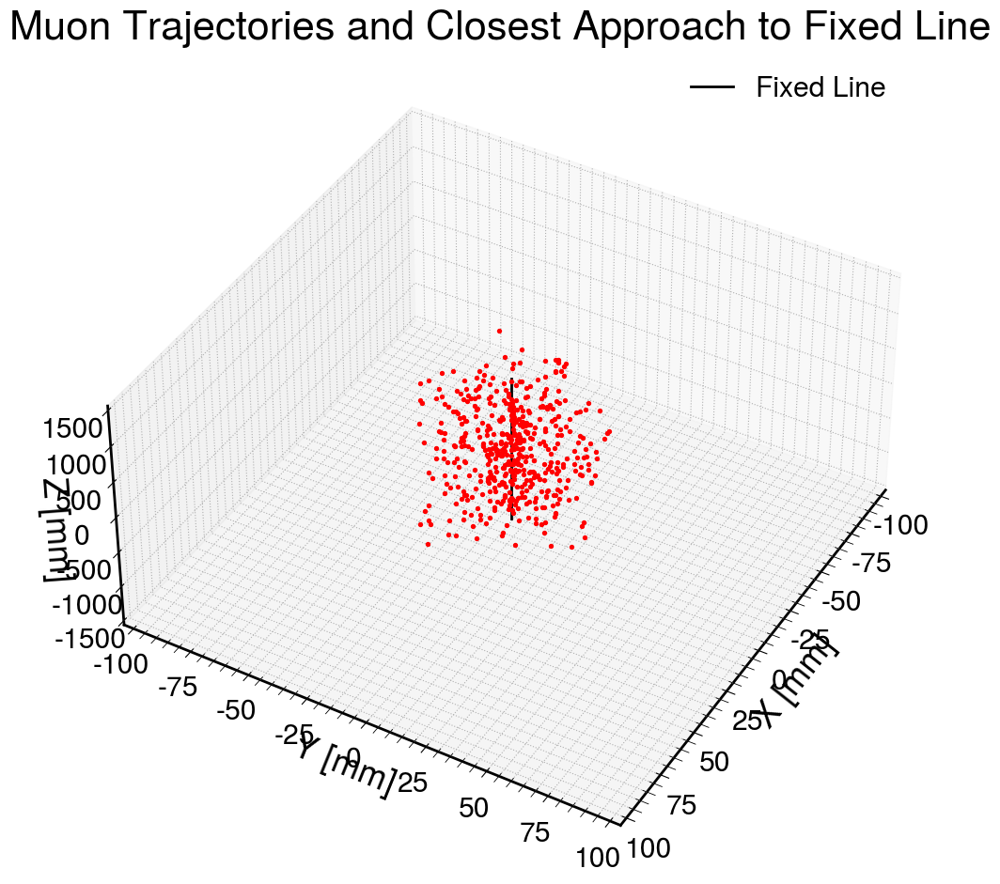

In [112]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

num = 500
# Arrays
x = arrays['muon']["MCParticles.vertex.x"][cell_cut][:num]  # in mm
y = arrays['muon']["MCParticles.vertex.y"][cell_cut][:num]
z = arrays['muon']["MCParticles.vertex.z"][cell_cut][:num]
px = arrays['muon']["MCParticles.momentum.x"][cell_cut][:num]  # in MeV/c
py = arrays['muon']["MCParticles.momentum.y"][cell_cut][:num]
pz = arrays['muon']["MCParticles.momentum.z"][cell_cut][:num]
status = arrays['muon']["MCParticles.generatorStatus"][cell_cut][:num]

# Filter for final state particles (status=1)
mask = (status == 1)
x, y, z, px, py, pz = x[mask], y[mask], z[mask], px[mask], py[mask], pz[mask]

# Unit direction vectors
p_mag = np.sqrt(px**2 + py**2 + pz**2)
ux, uy, uz = px/p_mag, py/p_mag, pz/p_mag

# ---- helper: closest points between 2 lines ----
def closest_point_between_lines(p1, d1, p2, d2):
    # ensure all are 1D numpy arrays
    p1 = np.asarray(p1, dtype=float).reshape(-1)
    d1 = np.asarray(d1, dtype=float).reshape(-1)
    p2 = np.asarray(p2, dtype=float).reshape(-1)
    d2 = np.asarray(d2, dtype=float).reshape(-1)
    
    r = p1 - p2
    a = np.dot(d1, d1)
    b = np.dot(d1, d2)
    c = np.dot(d2, d2)
    d = np.dot(d1, r)
    e = np.dot(d2, r)
    denom = a*c - b*b
    
    if np.isclose(denom, 0):  # parallel case
        t = np.dot(d1, (p2 - p1)) / a
        P1 = p1 + t*d1
        P2 = p2
    else:
        t = (b*e - c*d) / denom
        s = (a*e - b*d) / denom
        P1 = p1 + t*d1
        P2 = p2 + s*d2
    
    return P1, P2


# ---- setup plot ----
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Fixed line (beam axis)
p_fixed = np.array([0, 0, -1000])
d_fixed = np.array([0, 0, 1])
z_fixed = np.linspace(-1000, 1000, 100)
ax.plot(np.zeros_like(z_fixed), np.zeros_like(z_fixed), z_fixed, 'k-', linewidth=2, label="Fixed Line")

# Loop through muons
for i in range(len(x)):
    # Random line start & dir
    p_rand = np.array([x[i], y[i], z[i]])
    d_rand = np.array([ux[i], uy[i], uz[i]])
    
    # Trajectory until z=0
    z_points = np.linspace(z[i], 0, 50)
    x_points = x[i] + ux[i] * (z_points - z[i]) / uz[i]
    y_points = y[i] + uy[i] * (z_points - z[i]) / uz[i]
    
    # Convert to NumPy in case they're Awkward
    x_points = np.asarray(x_points)
    y_points = np.asarray(y_points)
    z_points = np.asarray(z_points)
    
    #ax.plot(x_points, y_points, z_points, alpha=0.6, linewidth=0.8, color='blue')
    
    # Closest points
    P_fixed, P_rand = closest_point_between_lines(p_fixed, d_fixed, p_rand, d_rand)
    #ax.plot([P_fixed[0], P_rand[0]], [P_fixed[1], P_rand[1]], [P_fixed[2], P_rand[2]], 'r--', alpha=0.4)
    ax.scatter(*P_rand, color='red', s=8)

# Formatting
ax.set_xlabel('X [mm]')
ax.set_ylabel('Y [mm]')
ax.set_zlabel('Z [mm]')
ax.set_title('Muon Trajectories and Closest Approach to Fixed Line')
ax.set_xlim(-100, 100)
ax.set_ylim(-100, 100)
ax.set_zlim(-1500, 1500)
ax.view_init(elev=40., azim=30)
ax.set_box_aspect([1, 1, 0.5])
plt.legend()
plt.tight_layout()
plt.show()


In [114]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure()

# Fixed line
z_fixed = np.linspace(-1000, 1000, 200)
fig.add_trace(go.Scatter3d(
    x=np.zeros_like(z_fixed),
    y=np.zeros_like(z_fixed),
    z=z_fixed,
    mode="lines",
    line=dict(color="black", width=10),
    name="Detector"
))

# Loop through muons
for i in range(len(x)):
    # trajectory to z=0
    z_points = np.linspace(z[i], -1000, 50)
    x_points = x[i] + ux[i]*(z_points - z[i])/uz[i]
    y_points = y[i] + uy[i]*(z_points - z[i])/uz[i]
    
    fig.add_trace(go.Scatter3d(
        x=x_points, y=y_points, z=z_points,
        mode="lines",
        line=dict(color="blue", width=2),
        opacity=0.6,
        showlegend=False
    ))

    # closest point segment
    p_rand = np.array([x[i], y[i], z[i]])
    d_rand = np.array([ux[i], uy[i], uz[i]])
    P_fixed, P_rand = closest_point_between_lines(p_fixed, d_fixed, p_rand, d_rand)
    '''
    fig.add_trace(go.Scatter3d(
        x=[P_fixed[0], P_rand[0]],
        y=[P_fixed[1], P_rand[1]],
        z=[P_fixed[2], P_rand[2]],
        mode="lines",
        line=dict(color="red", dash="dash"),
        opacity=0.5,
        showlegend=False
    ))'''
    fig.add_trace(go.Scatter3d(
        x=[P_rand[0]], y=[P_rand[1]], z=[P_rand[2]],
        mode="markers",
        marker=dict(color="red", size=4),
        showlegend=False,
        name="MC Muon Track Closest Point"
    ))
fig.add_trace(go.Scatter3d(
    x=[P_rand[0]], y=[P_rand[1]], z=[P_rand[2]],
    mode="markers",
    marker=dict(color="red", size=4),
    showlegend=True,
    name="MC Muon Track Closest Point"
))
fig.update_layout(
    scene=dict(
        xaxis=dict(title="X [mm]", range=[-50, 50]),
        yaxis=dict(title="Y [mm]", range=[-50, 50]),
        zaxis=dict(title="Z [mm]", range=[-1500, 1500]),
        aspectmode="manual",
        aspectratio=dict(x=1, y=1, z=0.5),
    ),
    title="CRY Muon Track Reconstruction at Truth Level Closest to Detector"
)

fig.show()


In [109]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure()

# --- Fixed detector line (z-axis) ---
z_fixed = np.linspace(-1000, 1000, 200)
fig.add_trace(go.Scatter3d(
    x=np.zeros_like(z_fixed),
    y=np.zeros_like(z_fixed),
    z=z_fixed,
    mode="lines",
    line=dict(color="black", width=10),
    name="Detector"
))

# --- Loop through muons ---
for i in range(len(x)):
    # Initial vertex and direction
    p_rand = np.array([x[i], y[i], z[i]])
    d_rand = np.array([ux[i], uy[i], uz[i]])
    
    # Long line representing muon trajectory (extend in both z directions)
    z_points = np.linspace(-1500, 1500, 100)
    x_points = x[i] + ux[i] * (z_points - z[i]) / uz[i]
    y_points = y[i] + uy[i] * (z_points - z[i]) / uz[i]
    
    fig.add_trace(go.Scatter3d(
        x=x_points, y=y_points, z=z_points,
        mode="lines",
        line=dict(color="blue", width=2),
        opacity=0.5,
        showlegend=False
    ))
    
    # Closest point between detector axis and muon track
    P_fixed, P_rand = closest_point_between_lines(p_fixed, d_fixed, p_rand, d_rand)
    
    # Mark the closest point on muon track
    fig.add_trace(go.Scatter3d(
        x=[P_rand[0]], y=[P_rand[1]], z=[P_rand[2]],
        mode="markers",
        marker=dict(color="red", size=4),
        showlegend=False
    ))
    
    # Draw connector from vertex to detector (optional)
    fig.add_trace(go.Scatter3d(
        x=[p_rand[0], P_rand[0]],
        y=[p_rand[1], P_rand[1]],
        z=[p_rand[2], P_rand[2]],
        mode="lines",
        line=dict(color="orange", dash="dot", width=2),
        opacity=0.7,
        showlegend=False
    ))

# --- Legend entry for closest points (just once) ---
fig.add_trace(go.Scatter3d(
    x=[P_rand[0]], y=[P_rand[1]], z=[P_rand[2]],
    mode="markers",
    marker=dict(color="red", size=4),
    showlegend=True,
    name="MC Muon Track Closest Point"
))

# --- Layout ---
fig.update_layout(
    scene=dict(
        xaxis=dict(title="X [mm]", range=[-100, 100]),
        yaxis=dict(title="Y [mm]", range=[-100, 100]),
        zaxis=dict(title="Z [mm]", range=[-1500, 1500]),
        aspectmode="manual",
        aspectratio=dict(x=1, y=1, z=0.5),
    ),
    title="CRY Muon Track Reconstruction with Closest Approach to Detector"
)

fig.show()


In [115]:
avg_x = ak.mean(pos_x, axis=1)
avg_y = ak.mean(pos_y, axis=1)
avg_z = ak.mean(pos_z, axis=1)

In [116]:
# Arrays
x = arrays['muon']["MCParticles.vertex.x"][cell_cut]  # in mm
y = arrays['muon']["MCParticles.vertex.y"][cell_cut]
z = arrays['muon']["MCParticles.vertex.z"][cell_cut]
px = arrays['muon']["MCParticles.momentum.x"][cell_cut] # in MeV/c
py = arrays['muon']["MCParticles.momentum.y"][cell_cut]
pz = arrays['muon']["MCParticles.momentum.z"][cell_cut]
status = arrays['muon']["MCParticles.generatorStatus"][cell_cut]

# Filter for final state particles (status=1)
mask = (status == 1)
x, y, z, px, py, pz = x[mask], y[mask], z[mask], px[mask], py[mask], pz[mask]

# Unit direction vectors
p_mag = np.sqrt(px**2 + py**2 + pz**2)
ux, uy, uz = px/p_mag, py/p_mag, pz/p_mag

p_fixed = np.array([0, 0, -1000])
d_fixed = np.array([0, 0, 1])
z_fixed = np.linspace(-1000, 1000, 100)
points = []
for i in range(len(x)):
    p_rand = np.array([x[i], y[i], z[i]])
    d_rand = np.array([ux[i], uy[i], uz[i]])
    P_fixed, P_rand = closest_point_between_lines(p_fixed, d_fixed, p_rand, d_rand)
    points.append(P_rand)

In [93]:
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=avg_x, y=avg_y, z=avg_z,
    mode="markers",
    marker=dict(color="red", size=4),
    showlegend=False,
    name="MC Muon Track Closest Point"
))
fig.update_layout(
    title="Average Cell Hits Position from Raw Output",
    scene=dict(xaxis_title='X (mm)', yaxis_title='Y (mm)', zaxis_title='Z (mm)'),
    width=800, height=600
)

Text(1, 0, 'Reco Truth X - Average Detector Cell X (mm)')

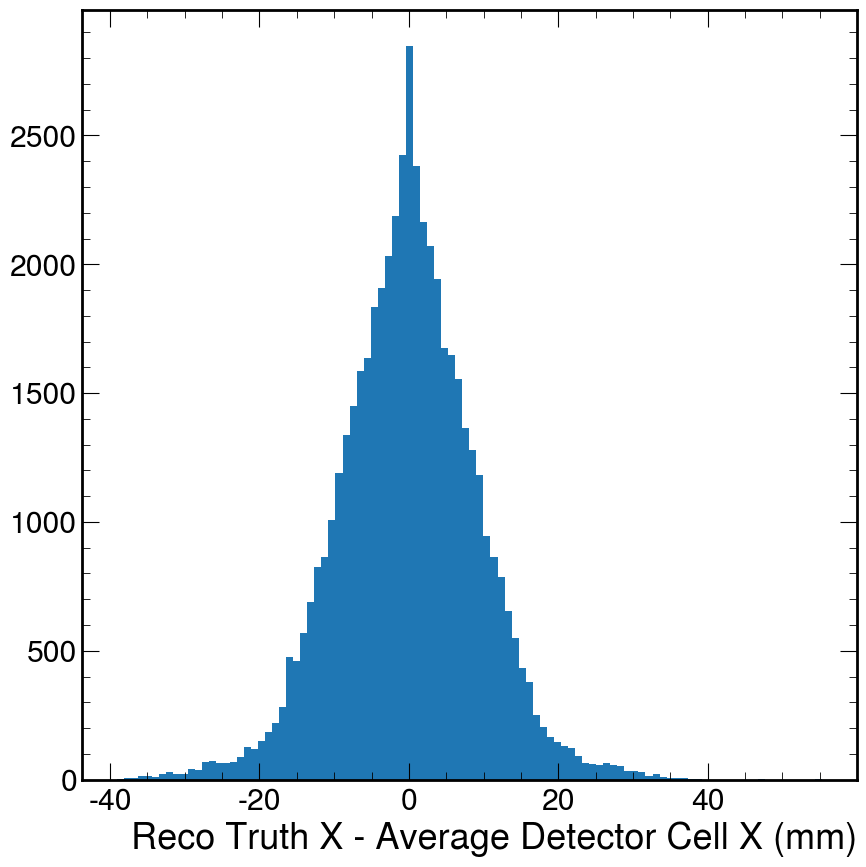

In [117]:
plt.hist(np.array(points)[:,0]-avg_x,bins=100)
#plt.yscale('log')
plt.xlabel('Reco Truth X - Average Detector Cell X (mm)')

Text(1, 0, 'Reco Truth Y - Average Detector Cell Y (mm)')

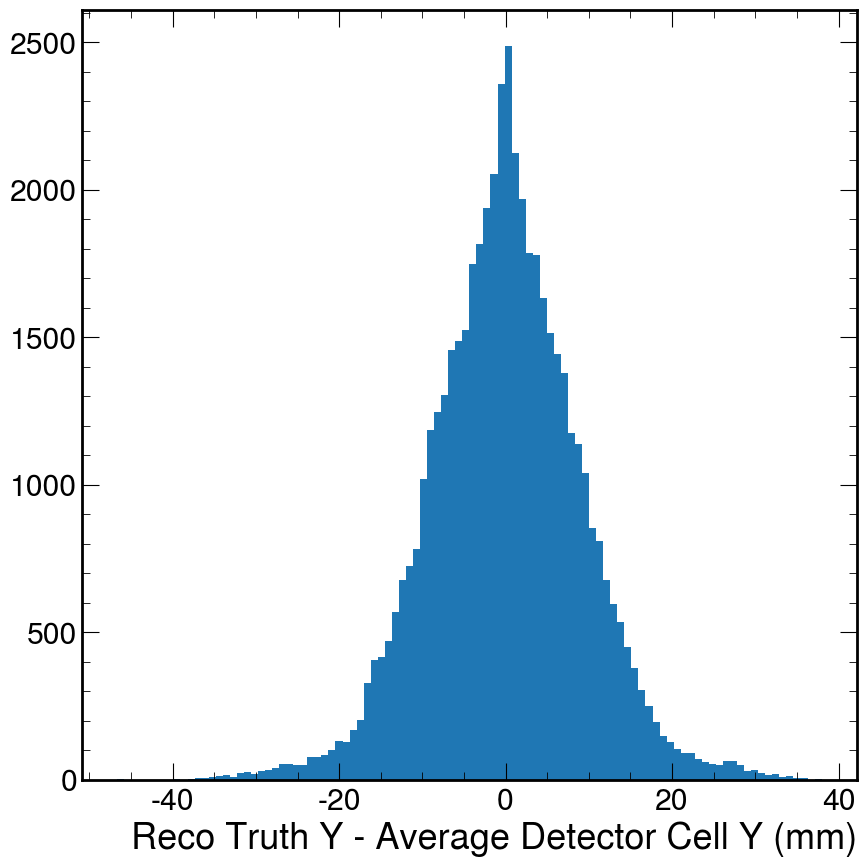

In [118]:
plt.hist(np.array(points)[:,1]-avg_y,bins=100)
#plt.yscale('log')
plt.xlabel('Reco Truth Y - Average Detector Cell Y (mm)')

Text(1, 0, 'Reco Truth Z - Average Detector Cell Z (mm)')

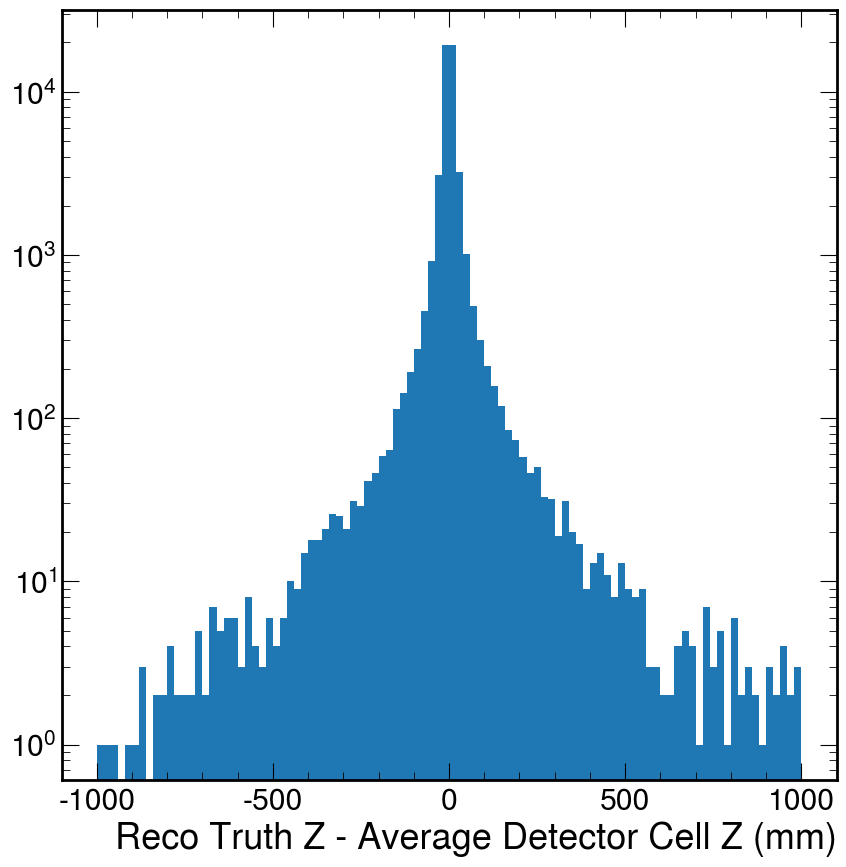

In [127]:
plt.hist(np.array(points)[:,2]-avg_z,bins=100,range=(-1000,1000))
plt.yscale('log')
plt.xlabel('Reco Truth Z - Average Detector Cell Z (mm)')

Text(1, 0, 'Average Detector Cell Z (mm)')

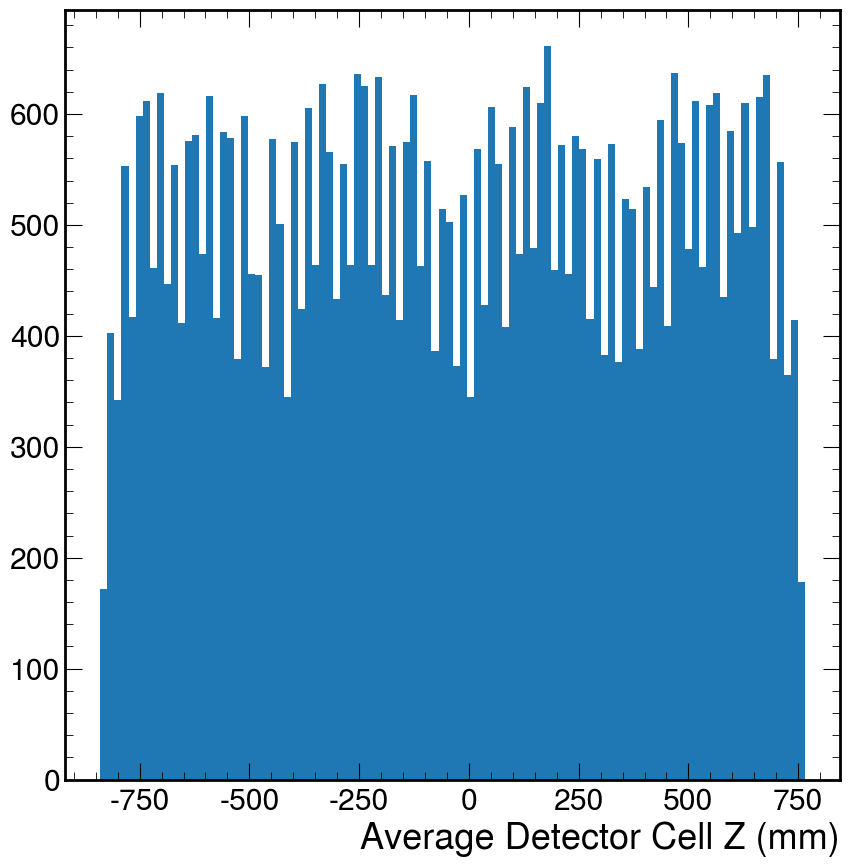

In [123]:
plt.hist(avg_z,bins=100)
#plt.yscale('log')
plt.xlabel('Average Detector Cell Z (mm)')

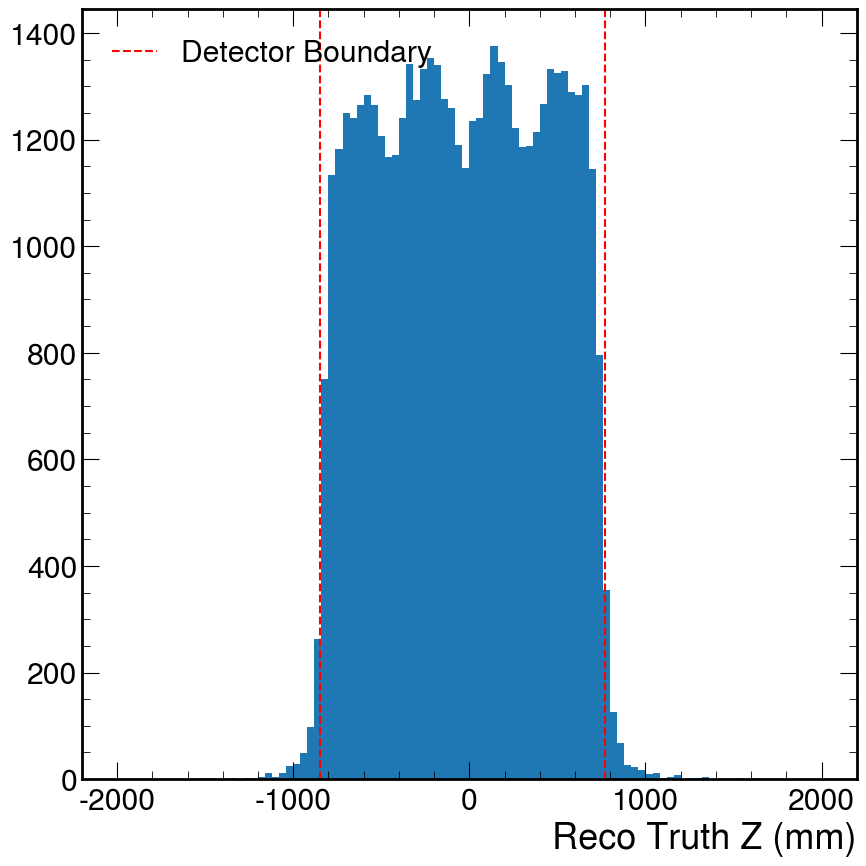

In [124]:
plt.hist(np.array(points)[:,2],bins=100,range=(-2000,2000))
#plt.yscale('log')
plt.xlabel('Reco Truth Z (mm)')
plt.axvline(-845.6,c='r',linestyle='dashed')
plt.axvline(771.4,c='r',linestyle='dashed',label='Detector Boundary')
plt.legend()

In [89]:
import numpy as np
import plotly.graph_objects as go

# --- Define line parameters ---
p1 = np.array([0, 0, 0])   # point on line 1
d1 = np.array([1, 1, 0.2]) # direction of line 1

p2 = np.array([0, 2, 1])   # point on line 2
d2 = np.array([1, -0.5, 0.3]) # direction of line 2

# --- Helper function ---
def closest_point_between_lines(p1, d1, p2, d2):
    r = p1 - p2
    a = np.dot(d1, d1)
    b = np.dot(d1, d2)
    c = np.dot(d2, d2)
    d = np.dot(d1, r)
    e = np.dot(d2, r)
    denom = a*c - b*b
    
    if np.isclose(denom, 0):  # parallel
        t = np.dot(d1, (p2 - p1)) / a
        P1 = p1 + t*d1
        P2 = p2
    else:
        t = (b*e - c*d) / denom
        s = (a*e - b*d) / denom
        P1 = p1 + t*d1
        P2 = p2 + s*d2
    return P1, P2

# --- Compute closest points ---
P1, P2 = closest_point_between_lines(p1, d1, p2, d2)

# --- Build line samples ---
t_vals = np.linspace(-1, 2, 50)
line1 = np.array([p1 + t*d1 for t in t_vals])
line2 = np.array([p2 + t*d2 for t in t_vals])

# --- Plot with Plotly ---
fig = go.Figure()

# Line 1
fig.add_trace(go.Scatter3d(
    x=line1[:,0], y=line1[:,1], z=line1[:,2],
    mode='lines', line=dict(color='blue', width=5), name="Line 1"
))

# Line 2
fig.add_trace(go.Scatter3d(
    x=line2[:,0], y=line2[:,1], z=line2[:,2],
    mode='lines', line=dict(color='green', width=5), name="Line 2"
))

# Closest points
fig.add_trace(go.Scatter3d(
    x=[P1[0]], y=[P1[1]], z=[P1[2]],
    mode='markers', marker=dict(size=6, color='blue'), name="Closest on Line 1"
))
fig.add_trace(go.Scatter3d(
    x=[P2[0]], y=[P2[1]], z=[P2[2]],
    mode='markers', marker=dict(size=6, color='green'), name="Closest on Line 2"
))

# Connector
fig.add_trace(go.Scatter3d(
    x=[P1[0], P2[0]], y=[P1[1], P2[1]], z=[P1[2], P2[2]],
    mode='lines', line=dict(color='red', dash='dash', width=4), name="Shortest Connector"
))

fig.update_layout(
    title="Closest Points Between Two Skew Lines (Interactive)",
    scene=dict(xaxis_title='X', yaxis_title='Y', zaxis_title='Z'),
    width=800, height=600
)

fig.show()
